## **Author**: *Sena Nur Bilgin*
## **Specialization**:  *DSA*
## **Subject**: *Assignment 2 - Object-Detection (CAT-DOG-MONKEY)*


#### **Packages & Module Calls**

*To begin, import the necessary Python packages and modules for the data analysis and machine learning tasks. In this section, we ensure all dependencies are loaded and ready to use.*



In [1]:
import sys
sys.path.append('../input/torchvisionreferencedetection/torchvision-reference-derection')


In [2]:
!pip install pycocotools
!pip install torch torchvision albumentations matplotlib opencv-python 


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 427.8/427.8 kB 15.2 MB/s eta 0:00:00


In [4]:
import os
import torch
import torchvision
import numpy as np
import pandas as pd
import cv2
from torch.utils.data import Dataset
import albumentations as A
import matplotlib.pyplot as plt
import time
from albumentations.pytorch.transforms import ToTensorV2
from torch.utils.data import DataLoader, Dataset
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.transforms.functional import to_tensor

import sys
sys.path.append('../input/torchvisionreferencedetection/torchvision-reference-derection')


#### **Dataset Description:** 

*This dataset is designed for training object detection models and contains hand-annotated images of dogs, cats, and monkeys. It includes both training and testing data formatted as TensorFlow's tfrecords. The training set consists of 469 images, while the test set comprises 51 images. Each image in the dataset is associated with its XML annotation file, and these annotations are also compiled into a CSV file for easy reference and manipulation.*

*The CSV files provided contain 1309 instances in the training set and 113 instances in the test set, each described by 8 attributes. These annotations focuses on three distinct classes: 'cat', 'monkey', and 'dog'. Overall, the main purpose is to map corresponding annotations from the csv to the each relavant image.*

#### **Column Descriptions of the test-training datasets.**

- **filename**: Name or identifier of the image file associated with the annotations.
- **width**: Width of the image in pixels.
- **height**: Height of the image in pixels.
- **class**: Class or category of the annotated object in the image (e.g., 1 for cats, 2 for monkeys).
- **xmin**: X-coordinate of the top-left corner of the bounding box around the annotated object.
- **ymin**: Y-coordinate of the top-left corner of the bounding box around the annotated object.
- **xmax**: X-coordinate of the bottom-right corner of the bounding box around the annotated object.
- **ymax**: Y-coordinate of the bottom-right corner of the bounding box around the annotated object.



#### ***Dataset Link**: [Monkey, Cat and Dog detection](https://www.kaggle.com/datasets/tarunbisht11/yolo-animal-detection-small)*






In [5]:
train_csv_path = "../input/yolo-animal-detection-small/train.csv"
test_csv_path = "../input/yolo-animal-detection-small/test.csv"
train_images = "../input/yolo-animal-detection-small/yolo-animal-detection-small/train"
test_images = "../input/yolo-animal-detection-small/yolo-animal-detection-small/test"

train_csv = pd.read_csv(train_csv_path)
test_csv = pd.read_csv(test_csv_path)

print(f"Train CSV shape: {train_csv.shape}")
print(f"Test CSV shape: {test_csv.shape}")

categories = train_csv["class"].unique()
print(f"Categories: {categories}")


Train CSV shape: (1309, 8)
Test CSV shape: (113, 8)
Categories: ['cat' 'monkey' 'dog']


#### **LabelMap Class: Categorical to Numerical Mapping**

*Here, the LabelMap class serves as a bridge between categorical labels ('cat', 'monkey', 'dog') and their corresponding numerical indices. It basically constructs mapping for efficient conversion in both directions: (1) FROM LABELS TO INDICES OR INDICES TO LABEL by using inverse method. Main purpose of mine is preprocesing data into numerical format.*




In [6]:
class LabelMap:
    def __init__(self, categories):
        """
        Initialize a LabelMap object.
        """
        self.map_dict = {cat: i + 1 for i, cat in enumerate(categories)}
        self.reverse_map_dict = {i + 1: cat for i, cat in enumerate(categories)}

    def fit(self, df, column):
        """
        Map categorical labels in a DataFrame column to integers using the internal mapping dictionary.
        """
        df[column] = df[column].map(self.map_dict)
        return df

    def inverse(self, df, column):
        """
        Map integer labels in a DataFrame column back to original categorical labels using the reverse mapping dictionary.
        """
        df[column] = df[column].map(self.reverse_map_dict)
        return df


In [7]:
label_map = LabelMap(categories)
train_csv = label_map.fit(train_csv, "class")
test_csv = label_map.fit(test_csv, "class")


In [8]:
test_csv

,filename,width,height,class,xmin,ymin,xmax,ymax
0,cats_000.jpg,474,632,1,103,72,436,603
1,cats_007.jpg,474,266,1,301,37,460,265
2,cats_007.jpg,474,266,1,90,1,392,266
3,cats_050.jpg,474,237,1,157,40,314,205
4,cats_072.jpg,474,266,1,187,1,474,266
...,...,...,...,...,...,...,...,...
108,monkey_groups_061.jpg,461,286,2,53,18,163,252
109,monkey_groups_061.jpg,461,286,2,124,19,166,94
110,monkey_groups_061.jpg,461,286,2,149,7,451,286
111,monkey_groups_061.jpg,461,286,2,244,35,435,273


*Here, we have transformed the categories into three unique numerical representations.*


In [15]:
unique_classes_test = test_csv['class'].unique()
print(f"Unique classes in test dataset: {unique_classes_test}")
# Cat:1 - Monkey:2 - Dog:3

Unique classes in test dataset: [1 2 3]


#### **AnimalDataSet Class**: 

*I have created the `AnimalDataset` class to facilitate object detection tasks using PyTorch. It manages a collection of annotated images, each associated with class labels and bounding box coordinates.*

*The class begins by loading a DataFrame (`df`) that contains essential details for each image, such as filename, class labels, and bounding box coordinates. It ensures each image is loaded, adjusts its color format to RGB for compatibility with PyTorch, and normalizes pixel values to the [0, 1] range. This preprocessing step prepares images for further processing and model training.*

*During data retrieval, the class extracts pertinent information from `df` for each image:*
- **Class Labels**: *Identifies the type of object present in the image (e.g., cats, monkeys) and maps these categorical labels to numerical values using a `LabelMap` class.*
- **Bounding Box Coordinates**: *Retrieves precise coordinates that delineate the location of each object within the image. These coordinates are crucial for training models to accurately detect and localize objects.*

*The extracted data is structured into a `target` dictionary, which organizes:*
- **Bounding Boxes**: *Coordinates formatted as tensors that define the region of interest for each annotated object.*
- **Labels**: *Numerical representations of object classes, facilitating model training and evaluation.*
- **Image ID**: *A unique identifier (`torch.tensor`) for each image, ensuring data integrity and alignment during batch processing.*
- **Additional Information**: *Includes area calculations (`area`) derived from bounding box dimensions and flags (`iscrowd`) that indicate whether multiple instances of an object overlap in the image.*

*Moreover, the class supports optional transformations (`transforms`) to augment data during preprocessing, enhancing model robustness and performance. Error handling ensures reliability by managing exceptions that may occur during data loading or processing.*

*In summary, the `AnimalDataset` class facilitates seamless data handling and preprocessing, essential for training and evaluating object detection models with accuracy and efficiency.*


In [16]:
class AnimalDataset(Dataset):
    def __init__(self, df, image_path, transforms=None):
        """
        Initialize an AnimalDataset object.
        """
        self.df = df
        self.image_path = image_path
        self.images = self.df["filename"].unique()
        self.transforms = transforms

    def __len__(self):
        """
        Return the number of unique images in the dataset.
        """
        return len(self.images)

    def __getitem__(self, idx):
        """
        Retrieve an image and its annotations from the dataset.
        """
        try:
            image_file = os.path.join(self.image_path, self.images[idx])
            img = cv2.imread(image_file)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).astype(np.float32) / 255.0

            image_data = self.df[self.df['filename'] == self.images[idx]]
            labels = torch.as_tensor(image_data["class"].values, dtype=torch.int64)
            xmins = image_data["xmin"].values
            ymins = image_data["ymin"].values
            xmaxs = image_data["xmax"].values
            ymaxs = image_data["ymax"].values
            boxes = torch.as_tensor(np.stack([xmins, ymins, xmaxs, ymaxs], axis=1), dtype=torch.float32)

            areas = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
            areas = torch.as_tensor(areas, dtype=torch.float32)
            image_id = torch.tensor([idx])
            iscrowd = torch.zeros((len(labels),), dtype=torch.int64)

            target = {
                "boxes": boxes,
                "labels": labels,
                "image_id": image_id,
                "area": areas,
                "iscrowd": iscrowd
            }

            if self.transforms is not None:
                transformed = self.transforms(image=img, bboxes=boxes, labels=labels)
                img = transformed["image"]
                target["boxes"] = torch.as_tensor(transformed["bboxes"], dtype=torch.float32)

            return img, target
        except Exception as e:
            print(f"Error loading image {self.images[idx]}: {e}")
            return None, None


#### **Dataset Transformations**: 
*Below, I have applied more advance transformations on both training and test datasets. These transformations defined with the `albumentations` library serve to augment and prepare images for object detection tasks using PyTorch. During `training`, the `HorizontalFlip` and `RandomBrightnessContrast` augmentations introduce `variations` such as `horizontal flipping` and `random adjustments to brightness and contrast`. The main purpose here is to enhance the model's ability to generalize to different orientations and lighting conditions. This is very important step to improve the training process, and decrease the loss. The `ToTensorV2` transformation converts both the image and its annotations into PyTorch tensors.*

*Similarly, the `testing` transformation applies `ToTensorV2` to ensure that images are `converted to tensors`, maintaining consistency in data format for model inference. `Bounding box parameters specified with bbox_params` ensure proper handling of bounding box annotations, crucial for accurately localizing objects in images during both training and testing phases.*

In [17]:
transform_train = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    ToTensorV2(p=1)
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['labels']))

transform_test = A.Compose([
    ToTensorV2(p=1)
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['labels']))


#### **Setting up DataLoaders for Object Detection**: 

*Here, I'm configuring two DataLoader instances to manage batches of data during object detection model training and testing. Given my limited computational resources, I've chosen a batch size of 4 for training, balancing efficiency with the ability to train the model effectively. For testing, I chose for a batch size of 1 without shuffling to maintain consistent data format during model evaluation. This setup optimizes batch handling efficiency and ensures data is prepared in tensor format, ideal for seamless integration with PyTorch-based object detection models.*

In [18]:
def collate_fn(batch):
    """
    Custom dataset handling in PyTorch DataLoader.
    """
    batch = list(filter(lambda x: x[0] is not None, batch))
    return tuple(zip(*batch))


In [19]:
train_dataset = AnimalDataset(train_csv, train_images, transform_train)
test_dataset = AnimalDataset(test_csv, test_images, transform_test)

data_loader_train = DataLoader(
    train_dataset, batch_size=4, shuffle=True, num_workers=0, collate_fn=collate_fn)

data_loader_test = DataLoader(
    test_dataset, batch_size=1, shuffle=False, num_workers=0, collate_fn=collate_fn)


## **Let's Visualize all the objects annotated!**

*The function iterates through batches of images and their annotations, visualizing bounding boxes on the images to check how the model interprets and predicts objects. For each image-target pair, it converts the image to a NumPy array, rearranging dimensions to match the expected format (permute(1, 2, 0)), then draws bounding boxes around detected objects using cv2.rectangle.*

*Note that this step is essential for verifying the model's performance and understanding its predictions during both training and testing phases.*

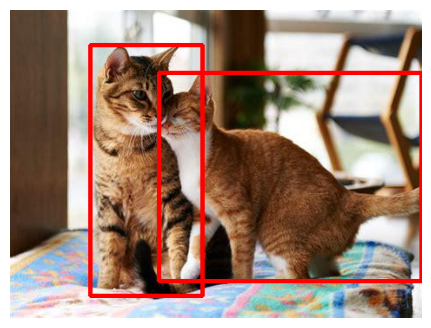

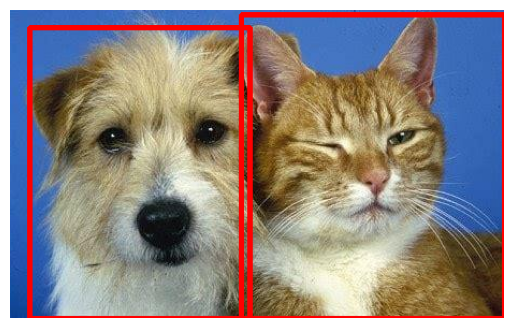

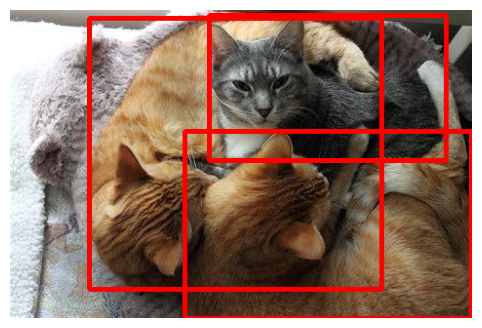

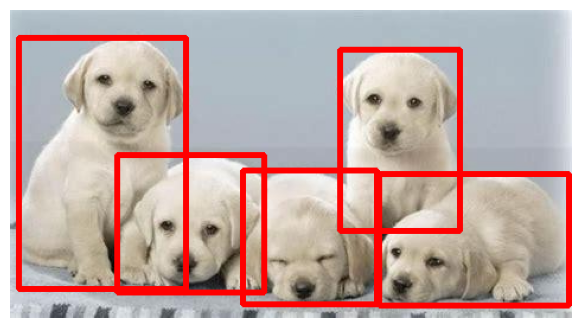

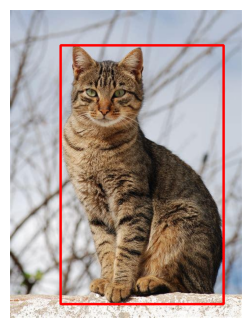

In [20]:
def plot_images(images, targets):
    """
    Plot images with bounding box annotations.
    """
    
    for image, target in zip(images, targets):
        sample = image.permute(1, 2, 0).cpu().numpy()
        fig, ax = plt.subplots(1, 1, figsize=(8, 4))
        boxes = target["boxes"].cpu().numpy().astype(np.int32)
        for box in boxes:
            cv2.rectangle(sample, (box[0], box[1]), (box[2], box[3]), (220, 0, 0), 3)
        ax.set_axis_off()
        ax.imshow(sample)
        plt.show()


images, targets = next(iter(data_loader_train))
plot_images(images, targets)

images, targets = next(iter(data_loader_test))
plot_images(images, targets)

*As demonstrated, we have successfully iterated over each image and effectively annotated each animal. The next step is to proceed with training a pretrained model.*


### **Model Selection - Object Detection Training** 

*I chose the `ResNet-50 model`, a type of convolutional neural network (CNN) known for its depth and structure with `50` layers. This model is effective at extracting important image features needed for accurate detection and classification of objects in images. Additionally,` ResNet-50 utilizes a region proposal strategy`: a Region Proposal Network (RPN) identifies `potential object bounding boxes in the image`, which are then refined to `improve localization` and classification accuracy.*

*I initialized the model with pretrained weights and configured the num_classes variable to account for the number of object categories plus an additional class for background objects. This setup enables the model to classify objects across specified categories. Next, I adjusted the model by replacing its default predictor with a custom FastRCNNPredictor designed to match the number of classes, --- linked with enhancing the model's accuracy in identifying objects.*

*Considering my computational resources, I designated the device for computations (preferably CUDA for GPU acceleration, otherwise CPU) and transferred the model accordingly.*

In [21]:
detection_model = fasterrcnn_resnet50_fpn(pretrained=True)
num_classes = len(categories) + 1  # Including background class
in_features = detection_model.roi_heads.box_predictor.cls_score.in_features
detection_model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
detection_model.to(device)


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:01<00:00, 149MB/s]  


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

### **Training & Arguments Descriptions**:

*The training function is set up with key components to work well with smaller batch sizes. By starting with pretrained weights and using Stochastic Gradient Descent (SGD) with momentum and weight decay, I ensure the model adjusts quickly to new data, helping it learn faster and generalize better across different examples. This setup also efficiently explores different ways the model can improve, using memory well and letting me fine-tune how it learns.*

*In each epoch, the function runs through the dataset, calculating how well the model is doing and updating its parameters with the train_one_epoch method. After each epoch, it checks how the model performs on a validation set with the evaluate function. This helps me understand if the model is improving correctly over time. The function keeps track of losses and other measures for each epoch, which helps me see how well the model is learning.*

*Finally, by plotting how losses change over epochs with plot_losses, I get a clear picture of how well the model is improving. This lets me adjust training if needed to get better results. Overall, this approach ensures the model trains effectively and performs well in detecting objects in images.*

### **Types of Losses in Object Detection**:

1. **Loss Classifier (`loss_classifier`)**:
   - *Measures how well the model classifies objects into different classes.*

2. **Loss Box Regression (`loss_box_reg`)**:
   - *Evaluates the error in predicting bounding box coordinates for object localization.*

3. **Loss Objectness (`loss_objectness`)**:
   - *Assesses the accuracy of predicting whether a proposed region contains an object or is background.*

4. **Loss RPN Box Regression (`loss_rpn_box_reg`)**:
   - *Specifically measures the regression loss for bounding box coordinates predicted by the Region Proposal Network (RPN).*

*These losses collectively guide the training of object detection models, optimizing both classification accuracy and bounding box localization precision. We will be checking those losses, to understand the training process better.*






In [92]:
def training(model, train_loader, val_loader, epochs):
    """
    This function iterates over the specified number of epochs, performing training using the train_loader,
    evaluating on the val_loader, and recording metrics such as loss and memory usage for each epoch.
    """
    params = [p for p in model.parameters() if p.requires_grad]
    optimizer = torch.optim.SGD(params, lr=0.001,
                                momentum=0.9, weight_decay=0.0005)
    
    lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                                   step_size=3,
                                                   gamma=0.1)
    
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)
    
    train_losses = [] 
    epoch_metrics = []  
    
    for epoch in range(epochs):
        train_loss, epoch_metric = train_one_epoch(model, optimizer, train_loader, device, epoch, print_freq=10)
        train_losses.append(train_loss)
        epoch_metrics.append(epoch_metric)
    
        lr_scheduler.step() # Update the learning rate
        
        evaluate(model, val_loader, device=device)
        
        print(f"Epoch [{epoch}/{epochs-1}], Train Loss: {train_loss:.4f}")
        print_metrics(epoch_metric)
        
    return train_losses, epoch_metrics



def train_one_epoch(model, optimizer, data_loader, device, epoch, print_freq=10):
    """
    Function to perform one epoch of training:
    This function iterates over the training data_loader for one epoch, computes losses, performs backpropagation,
    updates model parameters, and collects metrics such as loss, data loading time, and memory usage.
    """
    model.train()
    running_loss = 0.0
    epoch_metric = {
        'loss': [],
        'loss_classifier': [],
        'loss_box_reg': [],
        'loss_objectness': [],
        'loss_rpn_box_reg': [],
        'time': [],
        'data_time': [],
        'max_mem': []
    }
    
    start_time = time.time()
    
    for i, (images, targets) in enumerate(data_loader):
        data_time = time.time() - start_time
        epoch_metric['data_time'].append(data_time)
        
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        optimizer.zero_grad()
        loss_dict = model(images, targets)
        
        losses = sum(loss for loss in loss_dict.values())
        epoch_metric['loss'].append(losses.item())
        
        if 'loss_classifier' in loss_dict:
            epoch_metric['loss_classifier'].append(loss_dict['loss_classifier'].item())
        if 'loss_box_reg' in loss_dict:
            epoch_metric['loss_box_reg'].append(loss_dict['loss_box_reg'].item())
        if 'loss_objectness' in loss_dict:
            epoch_metric['loss_objectness'].append(loss_dict['loss_objectness'].item())
        if 'loss_rpn_box_reg' in loss_dict:
            epoch_metric['loss_rpn_box_reg'].append(loss_dict['loss_rpn_box_reg'].item())
        
        losses.backward()
        optimizer.step()

        running_loss += losses.item()
        
        if i % print_freq == 0:
            print(f"Epoch [{epoch}], Step [{i}/{len(data_loader)}], Loss: {losses.item():.4f}")
        
        epoch_metric['time'].append(time.time() - start_time)
        epoch_metric['max_mem'].append(torch.cuda.max_memory_allocated() / 1024.0 / 1024.0)
    
    return running_loss / len(data_loader), epoch_metric



def evaluate(model, data_loader, device):
    """
    This function performs evaluation (e.g., validation or test) using the provided data_loader
    and computes relevant metrics for model performance assessment.
    """
    pass



def print_metrics(epoch_metric):
    """
    This function prints mean, maximum, and minimum values for each metric collected
    during training or evaluation epochs.
    """
    for key, values in epoch_metric.items():
        if isinstance(values, list) and len(values) > 0:
            print(f"{key}: Mean = {sum(values) / len(values):.4f}, Max = {max(values):.4f}, Min = {min(values):.4f}")

    

In [93]:

train_losses, epoch_metrics = training(detection_model, data_loader_train, data_loader_test, epochs=10)
torch.save(detection_model.state_dict(), 'fasterrcnn_resnet50_fpn.pth')



Epoch [0], Step [0/118], Loss: 0.0853
Epoch [0], Step [10/118], Loss: 0.2214
Epoch [0], Step [20/118], Loss: 0.1785
Epoch [0], Step [30/118], Loss: 0.1813
Epoch [0], Step [40/118], Loss: 0.0761
Epoch [0], Step [50/118], Loss: 0.1920
Epoch [0], Step [60/118], Loss: 0.1984
Epoch [0], Step [70/118], Loss: 0.1210
Epoch [0], Step [80/118], Loss: 0.2241
Epoch [0], Step [90/118], Loss: 0.2391
Epoch [0], Step [100/118], Loss: 0.3742
Epoch [0], Step [110/118], Loss: 0.1363
Epoch [0/9], Train Loss: 0.1647
loss: Mean = 0.1647, Max = 0.3742, Min = 0.0378
loss_classifier: Mean = 0.0508, Max = 0.1330, Min = 0.0058
loss_box_reg: Mean = 0.0954, Max = 0.2297, Min = 0.0186
loss_objectness: Mean = 0.0021, Max = 0.0152, Min = 0.0000
loss_rpn_box_reg: Mean = 0.0163, Max = 0.0551, Min = 0.0032
time: Mean = 42.1617, Max = 82.7612, Min = 0.8095
data_time: Mean = 41.4900, Max = 82.6049, Min = 0.0307
max_mem: Mean = 8683.8545, Max = 8683.8545, Min = 8683.8545
Epoch [1], Step [0/118], Loss: 0.0820
Epoch [1], Ste

In [96]:
def print_epoch_metrics_keys(epoch_metrics):
    for i, metrics_dict in enumerate(epoch_metrics, start=1):
        print(f"Epoch {i} keys:")
        for key in metrics_dict.keys():
            print(key)
        print("-" * 20)

print_epoch_metrics_keys(epoch_metrics)


Epoch 1 keys:
loss
loss_classifier
loss_box_reg
loss_objectness
loss_rpn_box_reg
time
data_time
max_mem
--------------------
Epoch 2 keys:
loss
loss_classifier
loss_box_reg
loss_objectness
loss_rpn_box_reg
time
data_time
max_mem
--------------------
Epoch 3 keys:
loss
loss_classifier
loss_box_reg
loss_objectness
loss_rpn_box_reg
time
data_time
max_mem
--------------------
Epoch 4 keys:
loss
loss_classifier
loss_box_reg
loss_objectness
loss_rpn_box_reg
time
data_time
max_mem
--------------------
Epoch 5 keys:
loss
loss_classifier
loss_box_reg
loss_objectness
loss_rpn_box_reg
time
data_time
max_mem
--------------------
Epoch 6 keys:
loss
loss_classifier
loss_box_reg
loss_objectness
loss_rpn_box_reg
time
data_time
max_mem
--------------------
Epoch 7 keys:
loss
loss_classifier
loss_box_reg
loss_objectness
loss_rpn_box_reg
time
data_time
max_mem
--------------------
Epoch 8 keys:
loss
loss_classifier
loss_box_reg
loss_objectness
loss_rpn_box_reg
time
data_time
max_mem
--------------------


In [107]:
def plot_losses(epoch_metrics):
    """
    This function plots average total loss and optionally individual component losses (e.g., classifier loss,
    box regression loss, objectness loss, RPN box regression loss) over epochs, providing insights into
    the training progress and performance. It also prints the best performance and the corresponding epoch.
    """
    try:
        avg_losses = {}
        best_performance = {}
        
        for epoch, metric in enumerate(epoch_metrics, start=1):
            for key, value in metric.items():
                if key.startswith('loss'):
                    loss_type = key
                    if loss_type not in avg_losses:
                        avg_losses[loss_type] = []
                        best_performance[loss_type] = (float('inf'), 0)  # Initialize with infinite loss and epoch 0
                    
                    if isinstance(value, float):
                        avg_loss = value
                    elif isinstance(value, list):
                        avg_loss = sum(value) / len(value)
                    avg_losses[loss_type].append(avg_loss)
                    
                    # Update best performance if current loss is lower
                    if avg_loss < best_performance[loss_type][0]:
                        best_performance[loss_type] = (avg_loss, epoch)
        
        plt.figure(figsize=(12, 6))
        epochs = range(1, max(len(avg_losses[key]) for key in avg_losses) + 1)
        
        for loss_type, avg_loss_values in avg_losses.items():
            plt.plot(epochs, avg_loss_values, label=f'Average {loss_type}', linestyle='--')
        
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Different Training Losses over Epochs')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()
        
        for loss_type, (best_loss, best_epoch) in best_performance.items():
            print(f'Best performance for {loss_type}: {best_loss} at epoch {best_epoch}')
    
    except Exception as e:
        print(f"Error in plot_losses: {e}")
        print(f"Epoch Metrics: {epoch_metrics}")

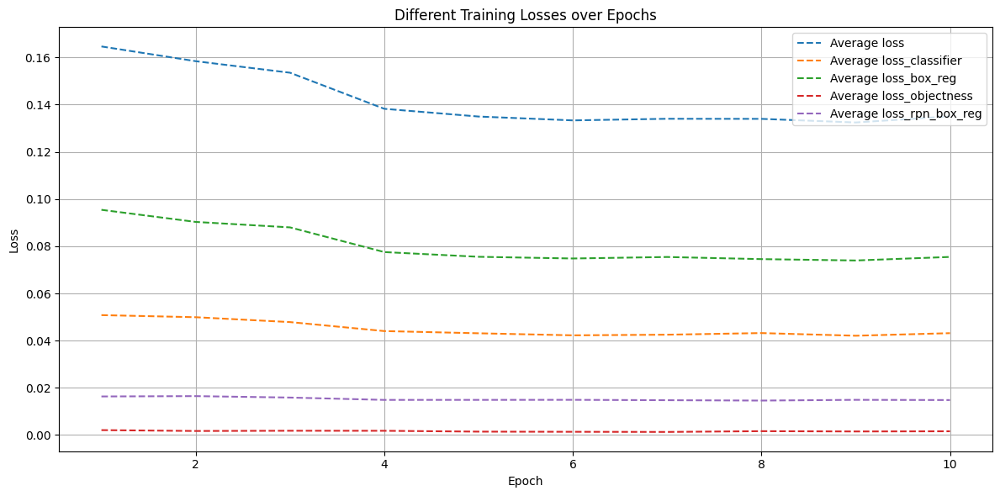

Best performance for loss: 0.1324433501241571 at epoch 9
Best performance for loss_classifier: 0.042071261593156446 at epoch 9
Best performance for loss_box_reg: 0.07396252304946972 at epoch 9
Best performance for loss_objectness: 0.0013045270363702805 at epoch 7
Best performance for loss_rpn_box_reg: 0.014594899460878538 at epoch 8


In [108]:
plot_losses(epoch_metrics)


*The performance metrics show that my object detection model is performing well. The overall loss reached its lowest value of `0.1324` at epoch 9, indicating effective learning. The classification loss, which measures how well the model predicts object classes, was lowest at `0.0421` at epoch 9, demonstrating strong accuracy. The bounding box regression loss, which checks the accuracy of the predicted bounding box coordinates, was best at `0.0740` at epoch 9, indicating good object localization. The objectness loss, showing how well the model identifies regions with objects, had its best value of `0.0013` at epoch 7, indicating effective region proposals. The RPN box regression loss, which measures the refinement of bounding box coordinates by the RPN, was lowest at `0.0146` at epoch 8, reflecting precise adjustments. These results show that the model is effective at detecting and classifying objects in images.*

*It's also worth mentioning that the model's performance plateaued after epoch 5. Implementing early stopping could reduce training time without compromising the model's performance. Additionally, I did not use cross-validation to avoid reducing the number of training examples.*

### **Can You Find My Favorite Animal?** 

*In the final step, I aimed to identify and store images and their predictions related to cats. The code extracts bounding boxes, labels, and confidence scores, then filters these to keep only the boxes and scores corresponding to `cats` `(label == 1)`, and further narrows them down based on a `confidence threshold`. If any cat predictions meet the threshold, the image and its cat-related predictions are saved.*

*The second part of the code defines a function, `plot_predicted_images`, which displays the images and draws rectangles around the predicted cat locations if their confidence scores exceed the threshold. This function helps visualize where the model thinks the cats are and how confident it is in those predictions.*

In [102]:
cat_images = [] 
cat_predictions = [] 


for image, prediction in zip(all_images, all_predictions):
    boxes = prediction['boxes'].cpu()  
    labels = prediction['labels'].cpu() 
    scores = prediction['scores'].cpu()
    
    cat_boxes = boxes[labels == 1]  
    cat_scores = scores[labels == 1]
    
    cat_boxes = cat_boxes[cat_scores >= threshold]
    cat_scores = cat_scores[cat_scores >= threshold]
    
    if len(cat_boxes) > 0:
        cat_images.append(image)
        cat_predictions.append({
            'boxes': cat_boxes,
            'scores': cat_scores,
            'labels': [1] * len(cat_boxes) 
        })

        
        
def plot_predicted_images(images, predictions, threshold, class_to_plot):
    """
    This function iterates over each image and its corresponding predictions, plots the image with
    predicted bounding boxes and labels for the specified class (class_to_plot) if their confidence
    score exceeds the threshold.
    """
        
    for image, prediction in zip(images, predictions):
        image = image.permute(1, 2, 0).numpy()
        boxes = prediction['boxes']
        labels = prediction['labels']
        scores = prediction['scores']
        
        fig, ax = plt.subplots(1, 1, figsize=(10, 8))
        ax.imshow(image)
        
        for box, label, score in zip(boxes, labels, scores):
            if score >= threshold and label == class_to_plot:
                box = box.int()
                xmin, ymin, xmax, ymax = box
                rect = plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                     fill=False, edgecolor='red', linewidth=2)
                ax.add_patch(rect)
                ax.text(xmin, ymin, f'Class {label} {score:.2f}', bbox=dict(facecolor='red', alpha=0.5))
        
        ax.axis('off')
        plt.show()



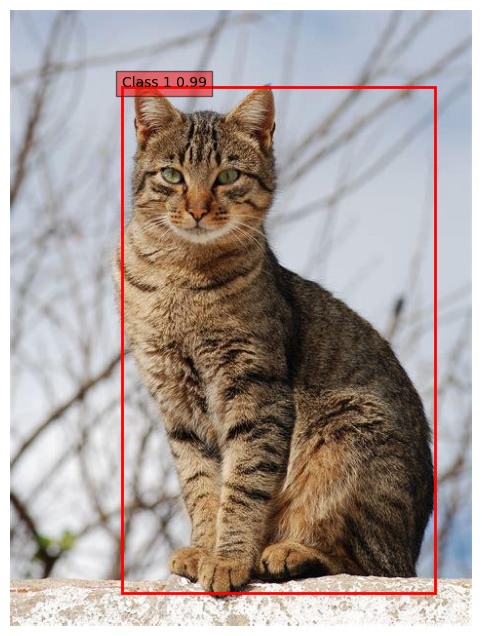

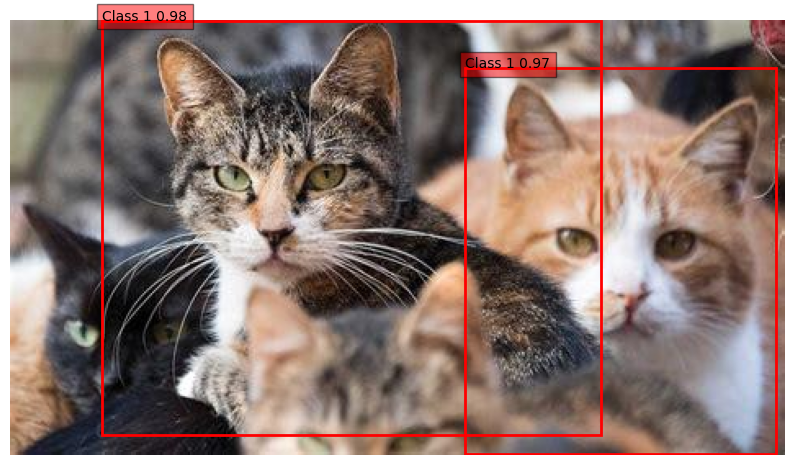

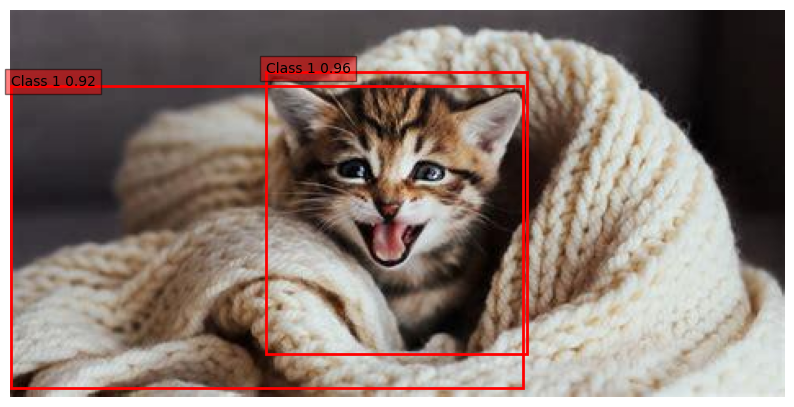

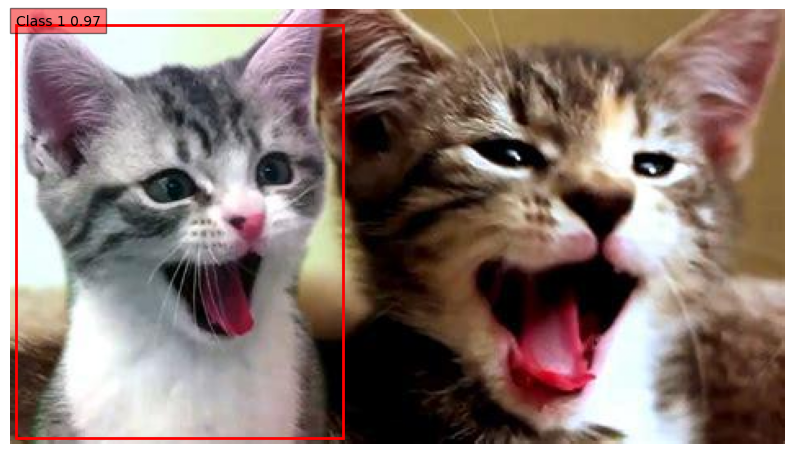

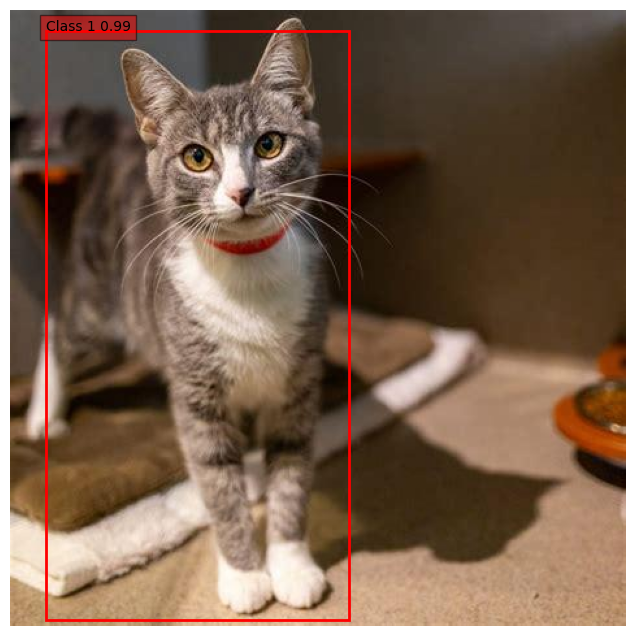

...

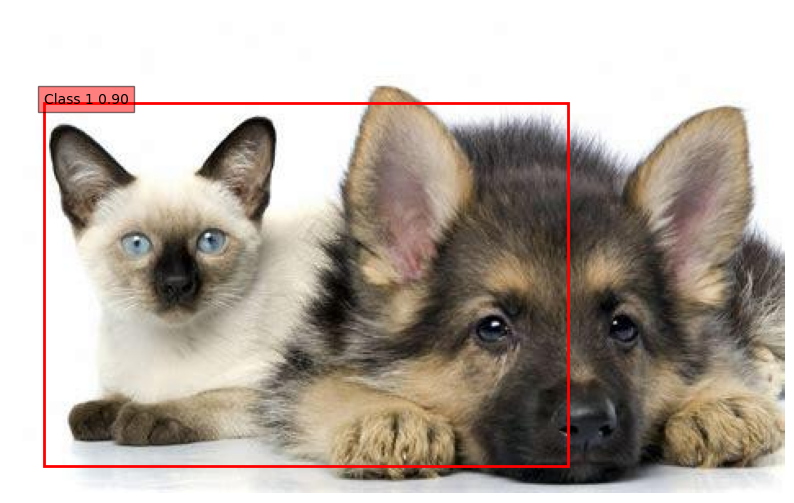

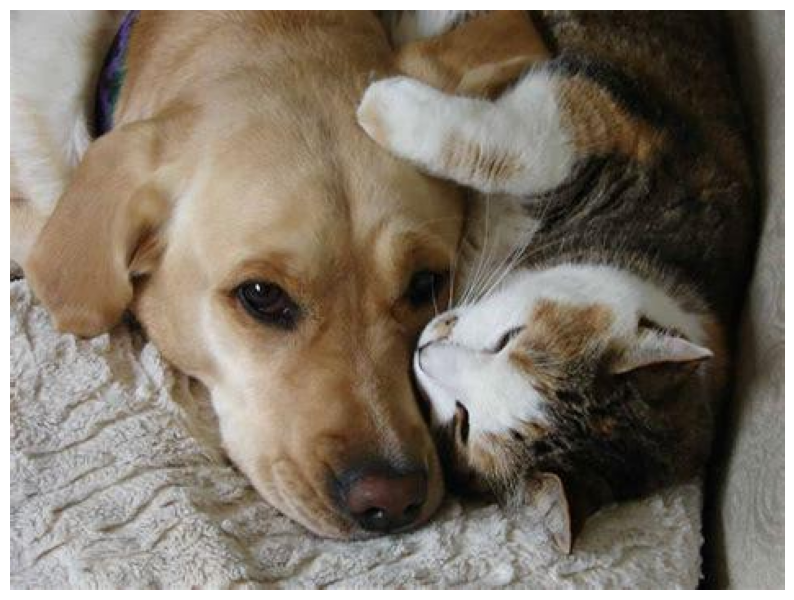

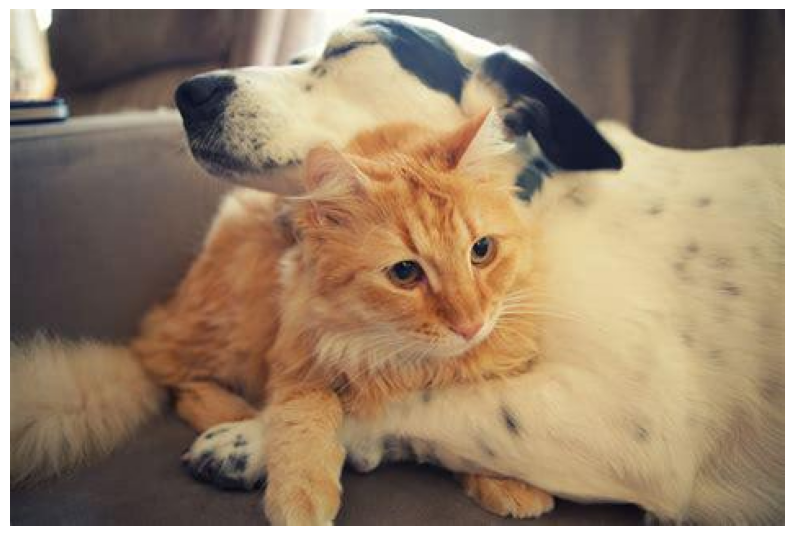

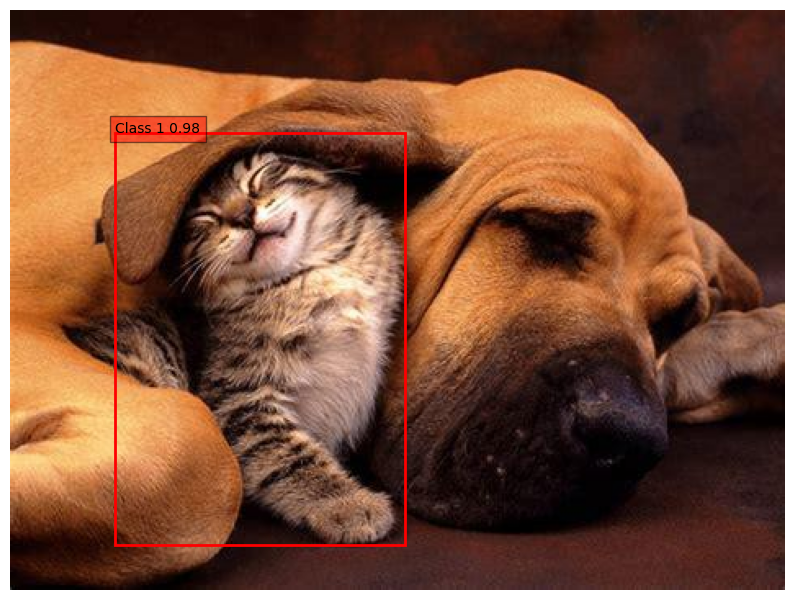

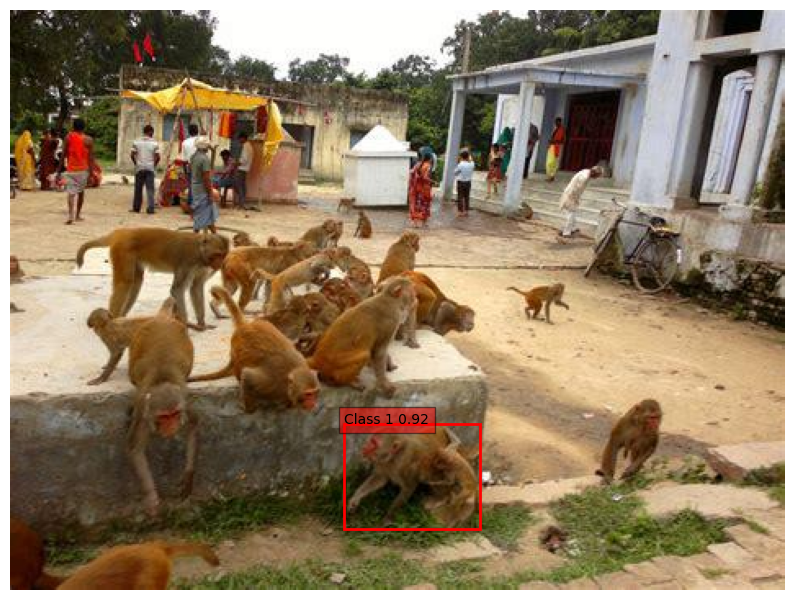

In [103]:
# Higher Threshold - Higher Precision, Lower Recall: 
plot_predicted_images(cat_images, cat_predictions, threshold=0.9, class_to_plot=1)


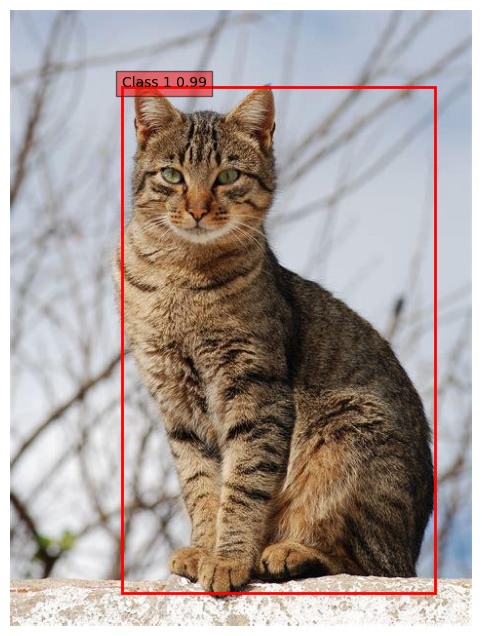

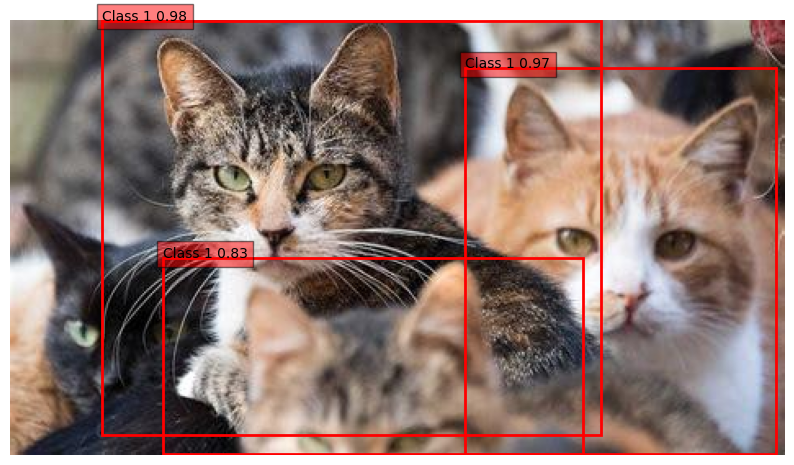

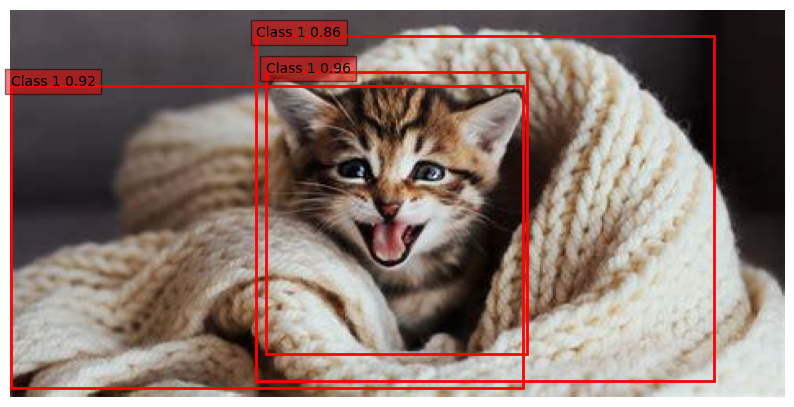

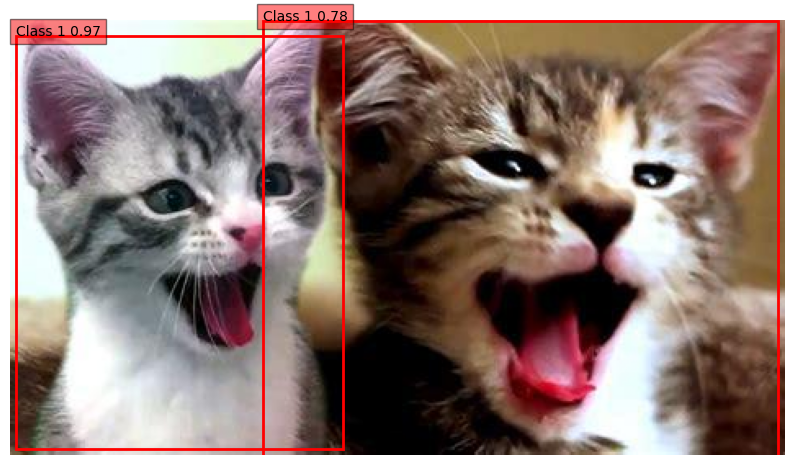

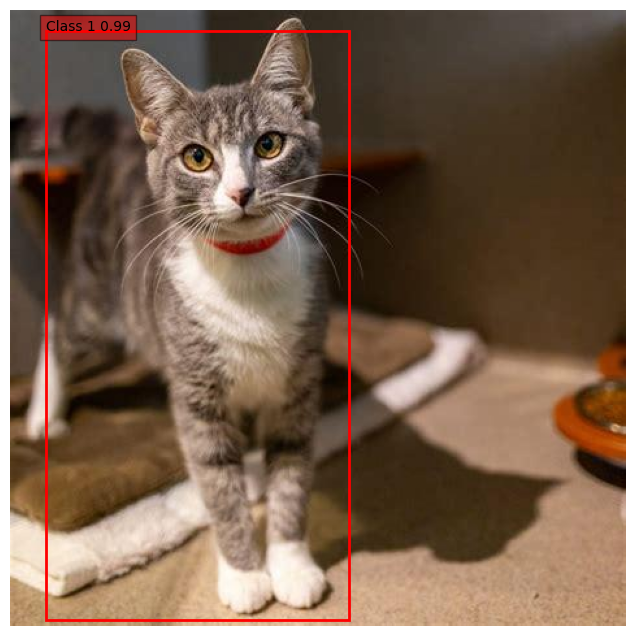

...

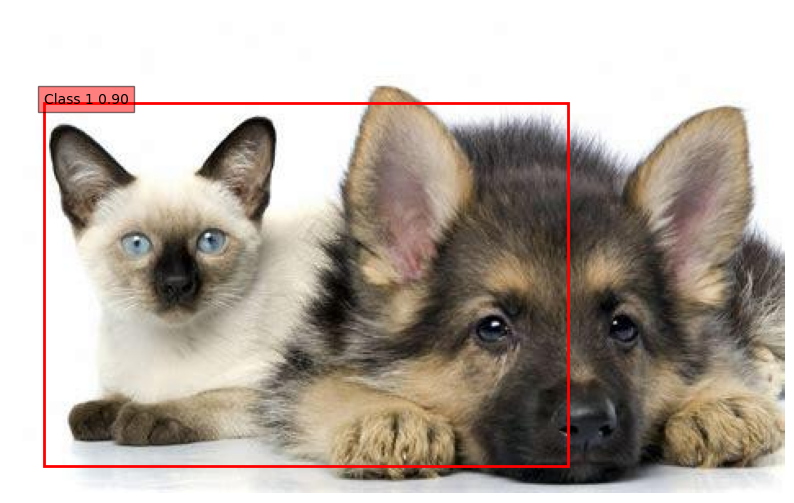

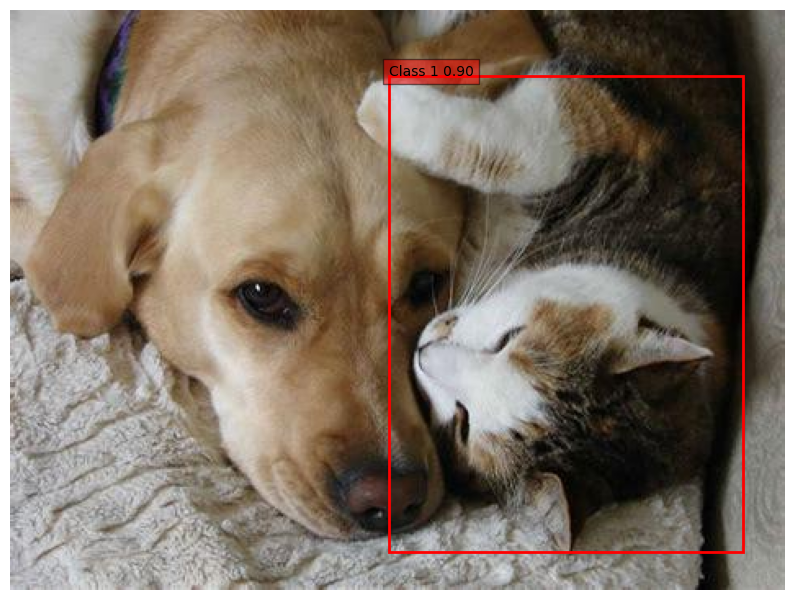

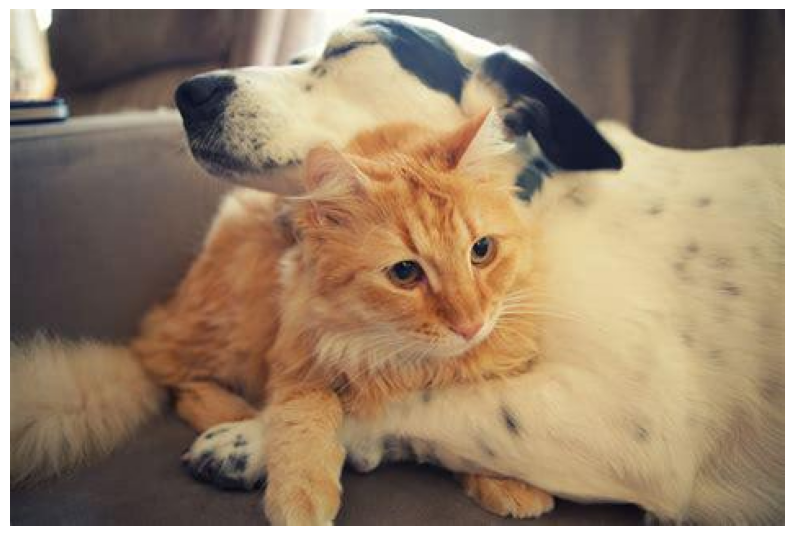

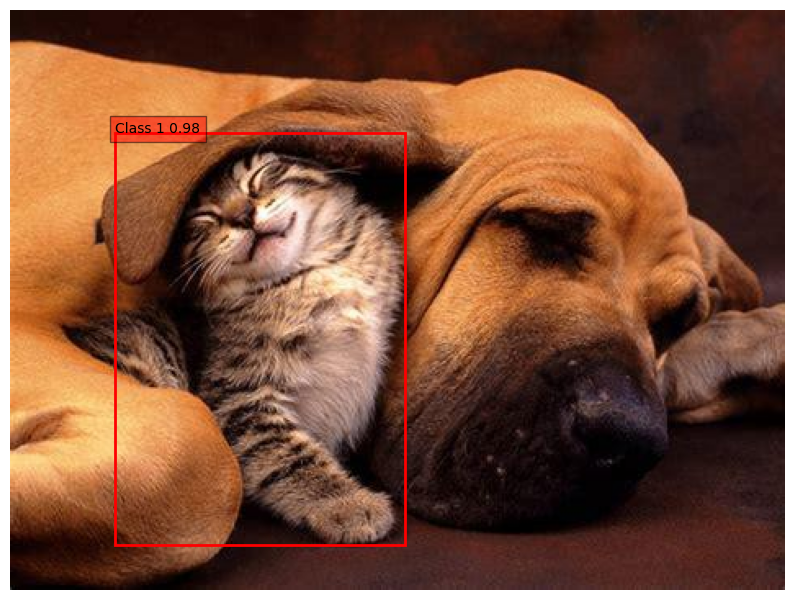

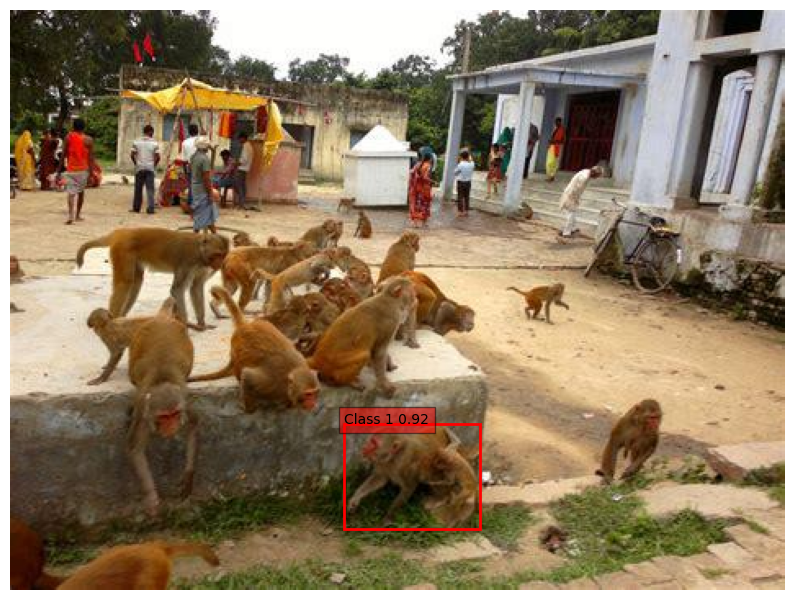

In [104]:
# Lower threshold - Lower Precision, Higher Recall: 
plot_predicted_images(cat_images, cat_predictions, threshold=0.7, class_to_plot=1)


### **Conclusion**:

*Adjusting the confidence threshold significantly influences the predictions of object detection models like Faster R-CNN, which I utilized in this project. This adjustment impacts both the quality and quantity of proposed object regions. When increasing the threshold, such as to `0.9` as shown earlier, the model prioritizes predictions with higher confidence scores. While these predictions are more likely to be accurate, they may also result in fewer predictions overall. Conversely, lowering the threshold, for instance to `0.7`, enables the model to include more predictions, potentially capturing instances it might have missed with a higher threshold.*

*For example, the model demonstrated improved performance on mixed test examples containing both cats and dogs when the confidence threshold was lower. This allowed the model to confidently classify more instances, even those with lower confidence scores.*

*This adjustment mirrors the internal thresholding mechanism of the Region Proposal Network (RPN) in Faster R-CNN. The RPN evaluates objectness scores to decide which regions should be proposed as potential objects. Both adjustments—setting the confidence threshold externally and the RPN's internal thresholds—aim to strike a balance between precision and recall. They are essential for effectively detecting and localizing objects in images by optimizing the model's capability to propose accurate and relevant object regions.*
